In [6]:
import os
import numpy as np
os.environ['HF_ENDPOINT']='https://hf-mirror.com'
import torch
from ip_adapter.utils import BLOCKS as BLOCKS
from ip_adapter.utils import CTRLNET_BLOCKS as CTRLNET_BLOCKS
from ip_adapter.utils import resize_content
import cv2
from PIL import Image
from transformers import AutoImageProcessor, AutoModel
from diffusers import (
    AutoencoderKL,
    ControlNetModel,
    StableDiffusionXLControlNetPipeline,

)
from ip_adapter import CSGO
from transformers import BlipProcessor, BlipForConditionalGeneration

In [7]:
def image_grid(imgs, rows, cols):
    assert len(imgs) == rows*cols

    w, h = imgs[0].size
    grid = Image.new('RGB', size=(cols*w, rows*h))
    grid_w, grid_h = grid.size
    
    for i, img in enumerate(imgs):
        grid.paste(img, box=(i%cols*w, i//cols*h))
    return grid

In [8]:
device = torch.device("cuda:1" if torch.cuda.is_available() else "cpu")

base_model_path =  "../../../base_models/stable-diffusion-xl-base-1.0"
image_encoder_path = "../../../base_models/IP-Adapter/sdxl_models/image_encoder"
csgo_ckpt = "/share2/xingpeng/DATA/blora/outputs/content_style_checkpoints_2/base_train_free_controlnet_S12_alldata_C_0_S_I_style_res_16_content_4_drop/checkpoint-70000/ip_adapter.bin"
# csgo_ckpt ='/share2/xingpeng/DATA/blora/outputs/content_style_checkpoints_2/base_train_free_controlnet_S12_alldata_C_0_S_I_zero2_style_res_32_content_res4_drop/checkpoint-220000/ip_adapter.bin'
pretrained_vae_name_or_path ='../../../base_models/sdxl-vae-fp16-fix'
controlnet_path = "../../../base_models/TTPLanet_SDXL_Controlnet_Tile_Realistic"
weight_dtype = torch.float16

In [9]:
blip_processor = BlipProcessor.from_pretrained("Salesforce/blip-image-captioning-large")
blip_model = BlipForConditionalGeneration.from_pretrained("Salesforce/blip-image-captioning-large").to(device)


vae = AutoencoderKL.from_pretrained(pretrained_vae_name_or_path,torch_dtype=torch.float16)
controlnet = ControlNetModel.from_pretrained(controlnet_path, torch_dtype=torch.float16,use_safetensors=True)
pipe = StableDiffusionXLControlNetPipeline.from_pretrained(
    base_model_path,
    controlnet=controlnet,
    torch_dtype=torch.float16,
    add_watermarker=False,
    vae=vae
)
pipe.enable_vae_tiling()


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

In [10]:
target_content_blocks = BLOCKS['content']
target_style_blocks = BLOCKS['style']
controlnet_target_content_blocks = CTRLNET_BLOCKS['content']
controlnet_target_style_blocks = CTRLNET_BLOCKS['style']

csgo = CSGO(pipe, image_encoder_path, csgo_ckpt, device, num_content_tokens=4,num_style_tokens=16,
                          target_content_blocks=target_content_blocks, target_style_blocks=target_style_blocks,controlnet_adapter=True,
                              controlnet_target_content_blocks=controlnet_target_content_blocks,
                              controlnet_target_style_blocks=controlnet_target_style_blocks,
                              content_model_resampler=True,
                              style_model_resampler=True,
                              )

loading controlnet_adapter


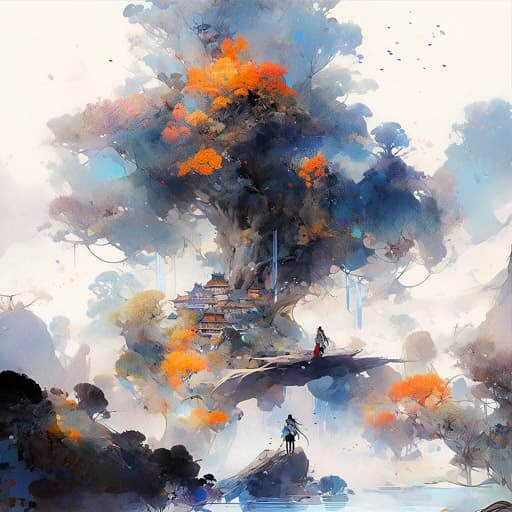

In [11]:
style_name = 'img_1.png'
content_name = 'img_0.png'
style_image = Image.open("../assets/{}".format(style_name)).convert('RGB')
content_image = Image.open('../assets/{}'.format(content_name)).convert('RGB')


style_image

In [12]:
with torch.no_grad():
    inputs = blip_processor(content_image, return_tensors="pt").to(device)
    out = blip_model.generate(**inputs)
    caption = blip_processor.decode(out[0], skip_special_tokens=True)

caption

/root/anaconda3/lib/python3.8/site-packages/transformers/generation/utils.py:1141: UserWarning: Using the model-agnostic default `max_length` (=20) to control the generation length. We recommend setting `max_new_tokens` to control the maximum length of the generation.
  warnings.warn(


'there is a small house with a sheep statue on top of it'

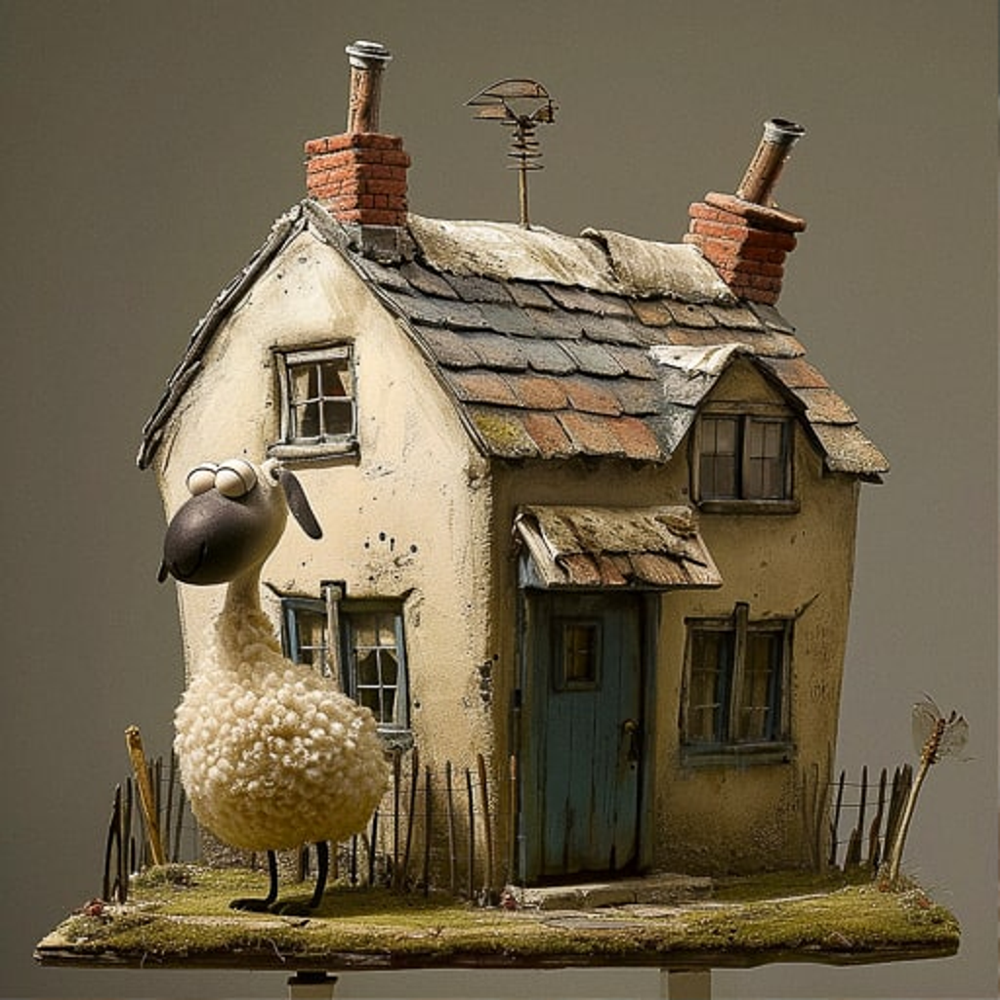

In [13]:
num_sample=4

width,height,content_image  = resize_content(content_image)
content_image

  0%|          | 0/50 [00:00<?, ?it/s]

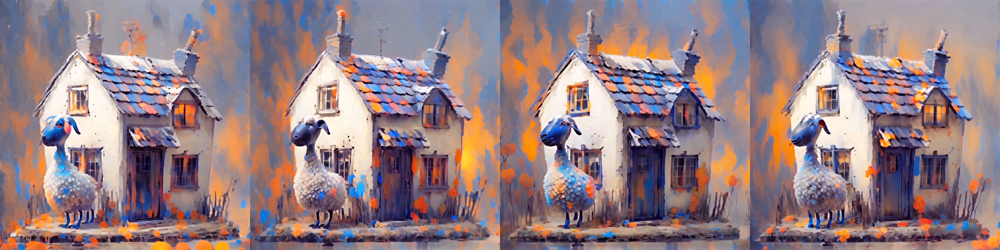

In [14]:
with torch.no_grad():
    images = csgo.generate(pil_content_image= content_image, pil_style_image=style_image,
                           prompt=caption,
                           negative_prompt= "text, watermark, lowres, low quality, worst quality, deformed, glitch, low contrast, noisy, saturation, blurry",
                           height=height,
                           width=width,
                           content_scale=1.0,
                           style_scale=1.0,
                           guidance_scale=7,
                           num_images_per_prompt=num_sample,
                           num_inference_steps=50,
                           num_samples=1,
                           seed=42,
                           image=content_image.convert('RGB'),
                           controlnet_conditioning_scale=0.6,
                          )
grid = image_grid(images, 1, num_sample)
grid

  0%|          | 0/50 [00:00<?, ?it/s]

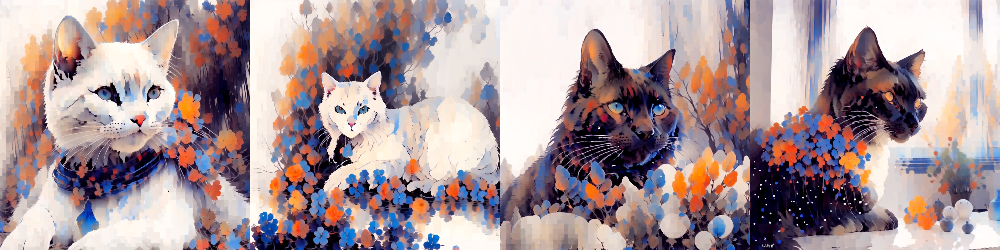

In [15]:
caption='a cat'
# import numpy as np
image =Image.fromarray(np.zeros((content_image.size[0],content_image.size[1], 3), dtype=np.uint8)).convert('RGB')
with torch.no_grad():
    images = csgo.generate(pil_content_image= content_image, pil_style_image=style_image,
                           prompt=caption,
                           negative_prompt= "text, watermark, lowres, low quality, worst quality, deformed, glitch, low contrast, noisy, saturation, blurry",
                           height=height,
                           width=width,
                           content_scale=0.5,
                           style_scale=1.0,
                           guidance_scale=10,
                           num_images_per_prompt=num_sample,
                           num_inference_steps=50,
                           num_samples=1,
                           seed=42,
                           image=image.convert('RGB'),
                           controlnet_conditioning_scale=0.01,
                          )
grid = image_grid(images, 1, num_sample)
grid

  0%|          | 0/50 [00:00<?, ?it/s]

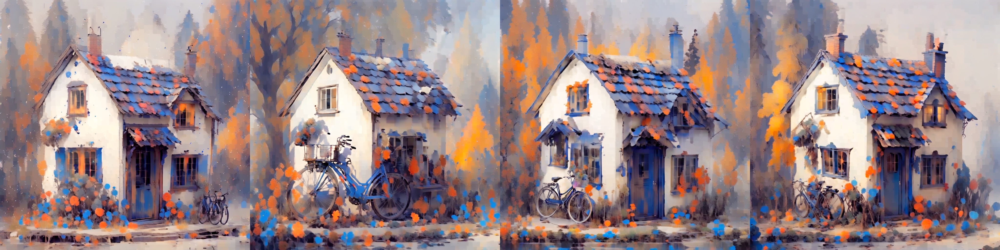

In [16]:
caption='there is a small house with a bike'
with torch.no_grad():
    images = csgo.generate(pil_content_image= content_image, pil_style_image=style_image,
                           prompt=caption,
                           negative_prompt= "text, watermark, lowres, low quality, worst quality, deformed, glitch, low contrast, noisy, saturation, blurry",
                           height=height,
                           width=width,
                           content_scale=0.5,
                           style_scale=1.0,
                           guidance_scale=7,
                           num_images_per_prompt=num_sample,
                           num_inference_steps=50,
                           num_samples=1,
                           seed=42,
                           image=content_image.convert('RGB'),
                           controlnet_conditioning_scale=0.4,
                          )
grid = image_grid(images, 1, num_sample)
grid